# Cross-Model Comparison Notebook

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from data.param_data_loader2 import ParamDL2
dataset = ParamDL2()

# dataset.summarize()

Processing Congestion
Processed 24 Congestions
Saved Congestion File
Processing Car Following
Processed 60 cf_events
Saved Car Following File
Datast Loaded. Preview of dataset: 
   driver  trip  congestion  cf_idx  type    time  gmm_n_cluster  \
0       1    53           0       0     0  1698.8              4   
1       1    53           0       0     0  1698.9              4   
2       1    53           0       0     0  1699.0              4   
3       1    53           0       0     0  1699.1              4   
4       1    53           0       0     0  1699.2              4   

   rank_0_cluster  rank_1_cluster  rank_2_cluster  ...  timeHeadway  VL_theta  \
0               2               1               0  ...     2.294240  0.137128   
1               2               1               0  ...     2.304333  0.137128   
2               2               1               0  ...     2.278744  0.138907   
3               2               1               0  ...     2.277959  0.140121   
4       

In [3]:
# Import models, before other cells, so there is no need to rerun some tests
from param_models import *
models = [
    BatchIDM(dataset.cf_events, mode='gpu'),
    BatchACC(dataset.cf_events, mode='gpu'),
    BatchGipps(dataset.cf_events, mode='gpu'), 
    BatchOVM(dataset.cf_events, mode='gpu'), 
    BatchFVDM(dataset.cf_events, mode='gpu')
]

best_params = {
    # "IDM": [ 1.00211871,  2.37290004,  3.06215215,  0.95444705, 23.66233063], 
    "IDM": [ 1.00211871,  2.37290004,  3.06215215,  0.95444705, 23.66233063], 
    "ACC": [8.4097757,  6.70674908, 1.23848021, 2.43299818, 5, 4,  0.45691102], 
    "Gipps":[  3.48966739, -10.,           1.02,        12.48262406,   1.76587988, -9.43270933], 
    "OVM": [8.30666840e-01, 1.51769309e+01, 1.00000000e-02, 2.83147426, 1.22445571e+01, 3.89127702e-01], 
    "FVDM": [1.02484083e+00, 2.20361022e+01, 1.00000000e-02, 2.28523306e+00, 2.97026129e+01, 3.18387707e-03, 1.00000000e-03]
}

In [4]:
import torch
import matplotlib.pyplot as plt
        
model_names = ["IDM", "ACC", "Gipps", "OVM", "FVDM", "GT"]

# def label_cells(sequence, threshold, slen):
#     batch_size, num_sequences, time_steps = sequence.shape
    
#     # Compute boolean masks for the conditions
#     above_threshold = sequence > threshold
#     below_threshold = sequence <= threshold
    
#     # Create shifted masks
#     above_threshold_shifted = torch.roll(above_threshold, shifts=1, dims=2)
#     below_threshold_shifted = torch.roll(below_threshold, shifts=1, dims=2)
    
#     # Ensure the first element in the sequence is not considered a transition
#     above_threshold_shifted[:, :, 0] = False
#     below_threshold_shifted[:, :, 0] = False
    
#     # Identify transitions
#     starts = above_threshold & below_threshold_shifted
#     ends = below_threshold & above_threshold_shifted
    
#     # Get indices of transitions
#     start_indices = starts.nonzero(as_tuple=False)
#     end_indices = ends.nonzero(as_tuple=False)
    
#     # Prepare the output
#     output = [[[] for _ in range(num_sequences)] for _ in range(batch_size)]
    
#     # Populate the output
#     for b in range(batch_size):
#         for s in range(num_sequences):
#             start_times = start_indices[(start_indices[:, 0] == b) & (start_indices[:, 1] == s), 2]
#             end_times = end_indices[(end_indices[:, 0] == b) & (end_indices[:, 1] == s), 2]
            
#             if start_times.numel() == 0:
#                 start_times = torch.tensor([0])
#             if end_times.numel() == 0:
#                 end_times = torch.tensor([time_steps - 1])
                
#             output[b][s] = list(zip(start_times.tolist(), end_times.tolist()))
            
#             # Deal with excess values
#             for i, (st,en) in enumerate(output[b][s]):
#                 if st >= slen[0, s] or en >= slen[0, s]:
#                     output[b][s] = output[b][s][:i]
#                     break
    
#     return output

def plot_sequences_with_labels(model, sequence, result, slen, fname, thres=0, y_lim=[0,0.2]):
    sequence = sequence.cpu()  # Move tensor to CPU
    batch_size, num_sequences, time_steps = sequence.size()
    
    colors = ['r', 'g', 'b', 'c', 'm', 'y']  # Define colors for the 5 sequences
    
    fig, axes = plt.subplots(12, 5, figsize=(40, 80))  # Create a 12x5 grid of subplots
    axes = axes.flatten()  # Flatten to easily index subplot
    
    for s in range(num_sequences):
        ax = axes[s]
        s_mask = model.mask[0, s, :].detach().cpu()
        tsq = model.t_st[0,s,s_mask].detach().cpu().numpy()
        for b in range(batch_size):
            # Plot the sequence
            seq = sequence[b, s, s_mask].numpy()
            
            ax.set_ylim(y_lim)
            ax.plot(tsq, seq, label=f'{model_names[b]}', color=colors[b])
            
        ax.hlines(thres, xmin=tsq[0], xmax=tsq[-1])
        ax.set_title(f'Sequence {s+1}')
        ax.legend()
        ax.grid(True)
    
    plt.tight_layout()
    plt.savefig(fname)
    plt.show()

In [5]:
naes = {
    "s":[],
    "v":[],
    "a":[]
}
for mod in models: 
    best_p = mod.hyperparams.from_array(best_params[mod.model_name.split("_")[0]], device=mod.device)
    mod.simulate(best_p, pbar=True)
    naes['s'].append(ParamBaseModelBatch.masked_NAE(mod.s_pred, mod.s, mod.mask))
    naes['v'].append(ParamBaseModelBatch.masked_NAE(mod.v_pred, mod.v, mod.mask))
    naes['a'].append(ParamBaseModelBatch.masked_NAE(mod.a_pred, mod.a, mod.mask))

100%|██████████| 6278/6278 [00:03<00:00, 1674.73it/s]


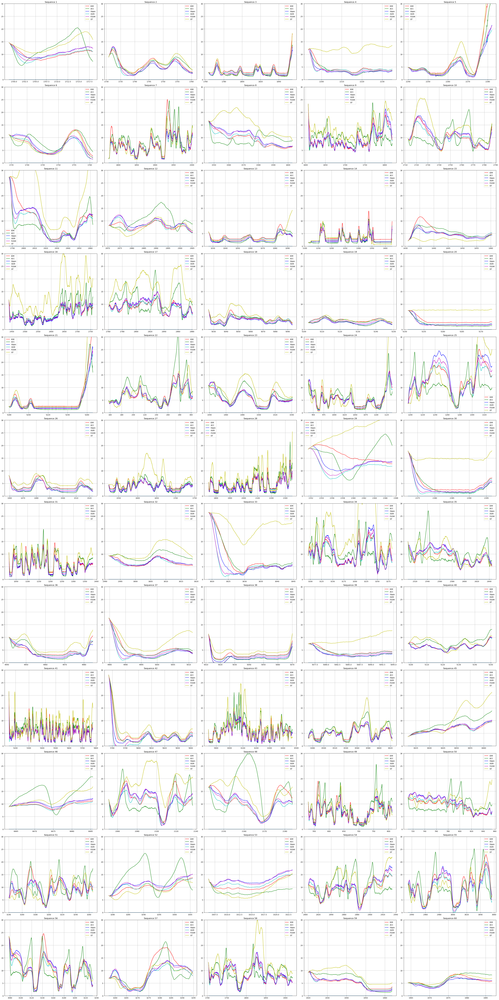

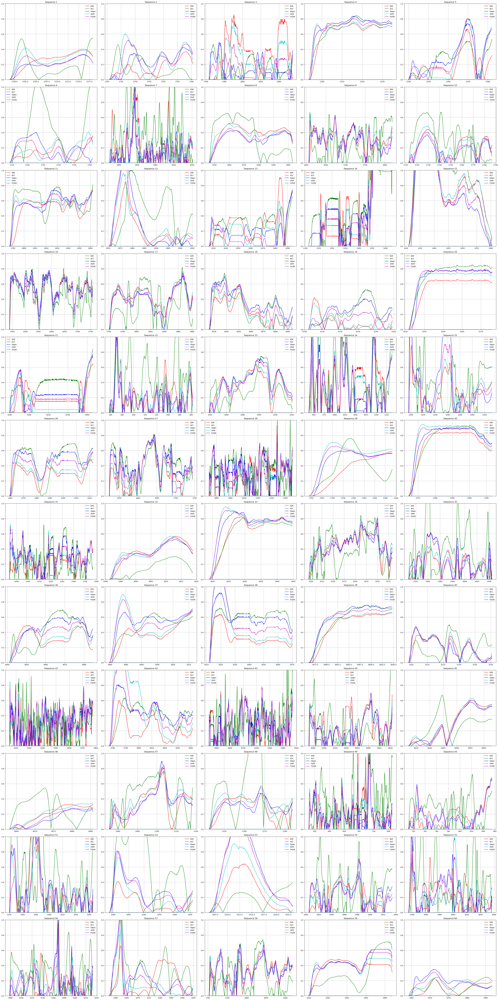

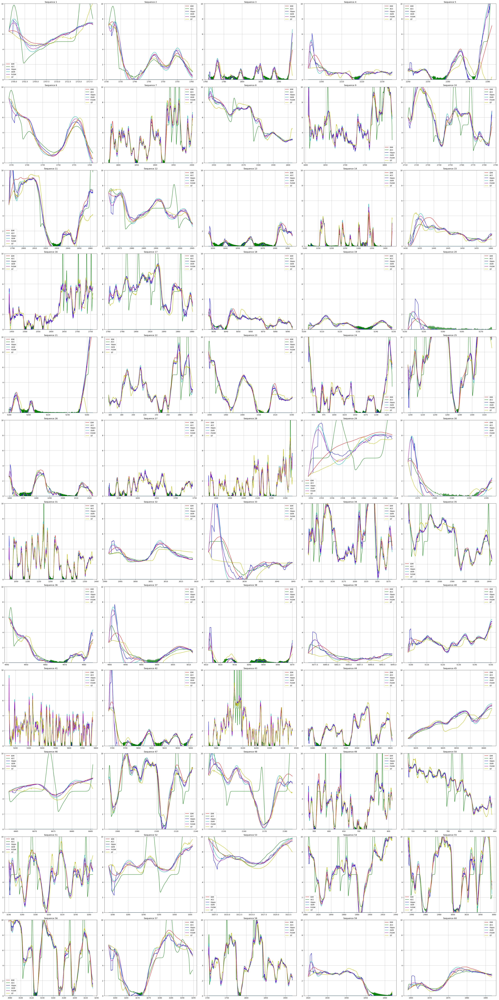

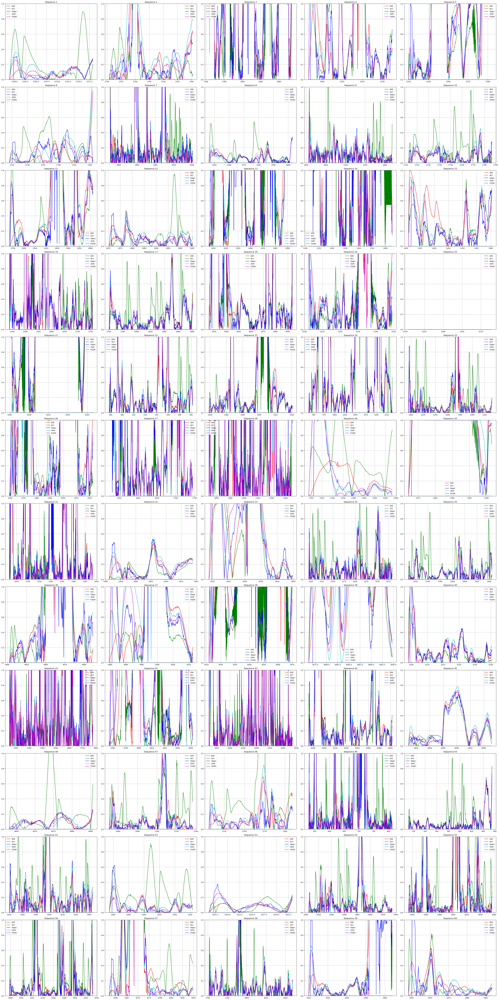

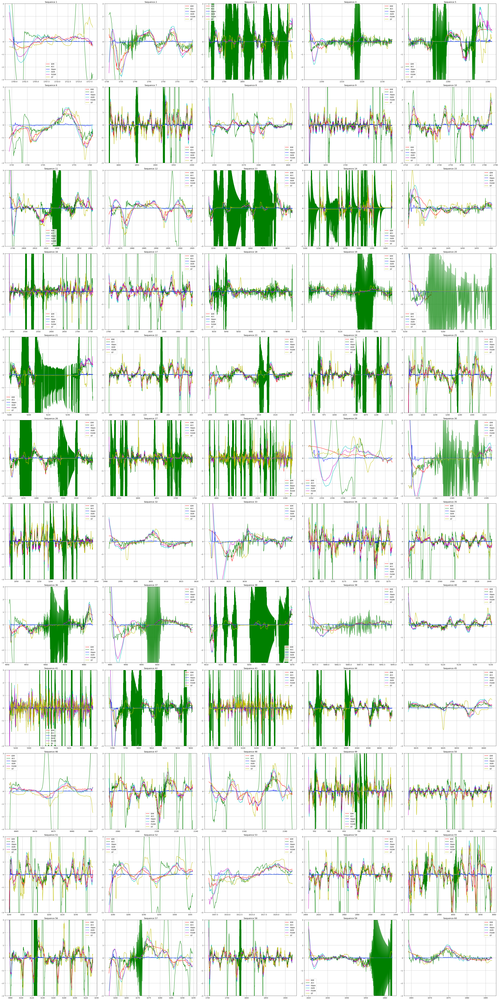

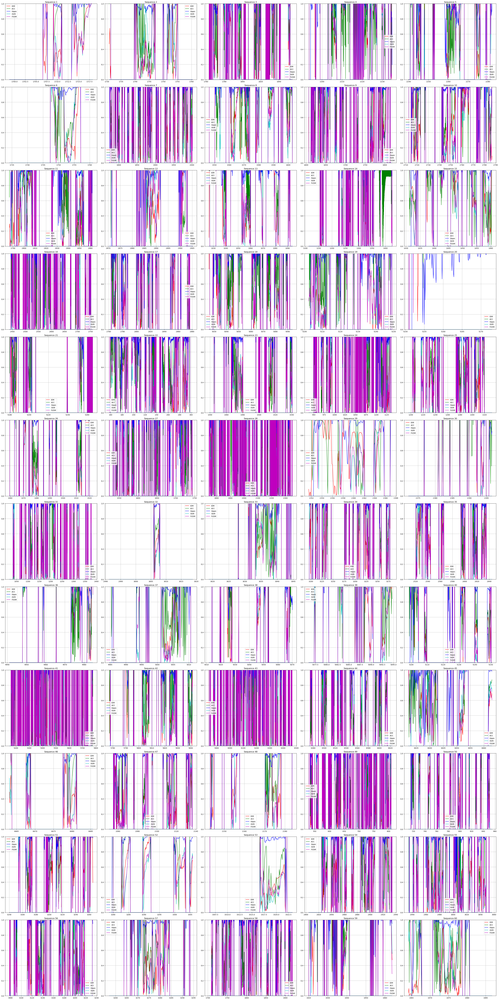

In [6]:
# for i, arr in enumerate(s_nae):
#     arr_flat = arr[mod.mask].detach().flatten().cpu().numpy()
#     print(f"For Model {model_names[i]}, Stats is {np.quantile(arr_flat, [0.01, 0.25, 0.5, 0.75, 0.99])}")

mod = models[0]
s_arr = torch.cat(naes['s'], axis=0)
v_arr = torch.cat(naes['v'], axis=0)
a_arr = torch.cat(naes['a'], axis=0)

# lab_out = label_cells(rmsne_seq, threshold=0.4, slen=mod.seq_lens)

y_lims = [[0, 30], [0, 10], [-3,3]]

for i, quant in enumerate(['s', 'v', 'a']):
    preds = [getattr(m, quant+"_pred") for m in models]
    preds.append(getattr(mod, quant))
    seqs = torch.cat(preds, axis=0)
    # plot_sequences_with_labels(mod, seqs, None, mod.seq_lens, quant+"_sequences.png", y_lim=y_lims[i])
    
    # errs = torch.cat(naes[quant], axis=0)
    # plot_sequences_with_labels(mod, errs, None, mod.seq_lens, quant+"_errs.png", y_lim=[0, 1])

In [7]:
preds = [getattr(m, "s_pred") for m in models]
preds.append(getattr(mod,"s"))
seqs = torch.cat(preds, axis=0).cpu()
batch_size, num_sequences, time_steps = seqs.size()

colors = ['r', 'g', 'b', 'c', 'm', 'y']  # Define colors for the 5 sequences

fig, axes = plt.subplots(12, 5, figsize=(40, 80))  # Create a 12x5 grid of subplots
axes = axes.flatten()  # Flatten to easily index subplot

for s in range(num_sequences):
    ax = axes[s]
    s_mask = mod.mask[0, s, :].detach().cpu()
    tsq = mod.t_st[0,s,s_mask].detach().cpu().numpy()
    for b in range(batch_size):
        # Plot the sequence
        seq = seqs[b, s, s_mask].numpy()
        ax.set_ylim([0,30])
        ax.plot(tsq, seq, label=f'{model_names[b]}', color=colors[b])
        
    ax.set_title(f'Sequence {s+1}')
    ax.legend()
    ax.grid(True)

plt.tight_layout()
plt.show()
plt.close()

TypeError: plot_sequences_with_labels() missing 1 required positional argument: 'fname'